In [3]:
from torchvision import transforms
from data import CustomDataset
from torch.utils.data import Dataset, DataLoader, RandomSampler, SequentialSampler
import torch 
from train import create_model
import matplotlib.pyplot as plt 
import matplotlib.patches as patches 
import numpy as np
from tqdm import tqdm 

In [2]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [3]:
class_names = ['background','Capacitor', 'Cylinder', 'Motor', 'Shock absorber', 'container']

In [4]:
label2idx = {label: idx for idx, label in enumerate(class_names)}
idx2label = {idx: label for idx, label in enumerate(class_names)}
idx2label

{0: 'background',
 1: 'Capacitor',
 2: 'Cylinder',
 3: 'Motor',
 4: 'Shock absorber',
 5: 'container'}

In [5]:
TEST_IMAGES = "/home/anukul/Thesis_Data/Steel_Scrap_detection/test/images"
TEST_LABELS = "/home/anukul/Thesis_Data/Steel_Scrap_detection/test/labels"

In [17]:
test_transforms = transforms.Compose([
        transforms.ToTensor(),
        # transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])

test_dataset = CustomDataset(TEST_IMAGES, TEST_LABELS, (640, 640), transforms=test_transforms)
test_loader = DataLoader(test_dataset, batch_size=1, num_workers=0, shuffle=False)

In [18]:
model = create_model(num_classes=6)
model.to(device)
checkpoint_path = "/home/anukul/Thesis_Object_Detection_Code/recent_epoch_model.pth"
checkpoint = torch.load(checkpoint_path, weights_only=False)
model.load_state_dict(checkpoint['model_state_dict'])

<All keys matched successfully>

In [19]:
model

FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (4): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (

In [20]:
def visualize_predictions(image, boxes, labels, scores, threshold=0.5):
    """
    Visualize bounding boxes on image
    """
    # Convert tensor to PIL Image if needed
    if isinstance(image, torch.Tensor):
        if image.is_cuda:
            image = image.cpu()
        # Assuming image is in format [C, H, W]
        image = image.permute(1, 2, 0).numpy()
        if image.max() <= 1.0:
            image = (image * 255).astype(np.uint8)
    
    fig, ax = plt.subplots(1, 1, figsize=(12, 8))
    ax.imshow(image)
    
    # Filter predictions by confidence threshold
    valid_indices = scores >= threshold
    boxes = boxes[valid_indices]
    labels = labels[valid_indices]
    scores = scores[valid_indices]
    
    # Draw bounding boxes
    for box, label, score in zip(boxes, labels, scores):
        x1, y1, x2, y2 = box
        width = x2 - x1
        height = y2 - y1
        
        # Create rectangle patch
        rect = patches.Rectangle((x1, y1), width, height, 
                               linewidth=2, edgecolor='red', facecolor='none')
        ax.add_patch(rect)
        
        # Add label and score
        label_text = f'{class_names[label]}: {score:.2f}'
        ax.text(x1, y1-5, label_text, fontsize=10, color='red', 
                bbox=dict(boxstyle="round,pad=0.3", facecolor='white', alpha=0.7))
    
    ax.set_title(f'Predictions (threshold: {threshold})')
    ax.axis('off')
    plt.tight_layout()
    plt.show()

Testing:   3%|▎         | 1/34 [00:00<00:03,  9.86it/s]


Image 1:
Number of detections (confidence > 0.7): 0
No detections above threshold

Image 2:
Number of detections (confidence > 0.7): 3
Predictions:
  1. Class: Cylinder (ID: 2), Score: 0.992, Box: [113.4, 347.2, 328.3, 417.2]
  2. Class: Cylinder (ID: 2), Score: 0.968, Box: [7.0, 352.5, 174.9, 484.1]
  3. Class: Cylinder (ID: 2), Score: 0.964, Box: [360.9, 364.5, 539.1, 415.6]


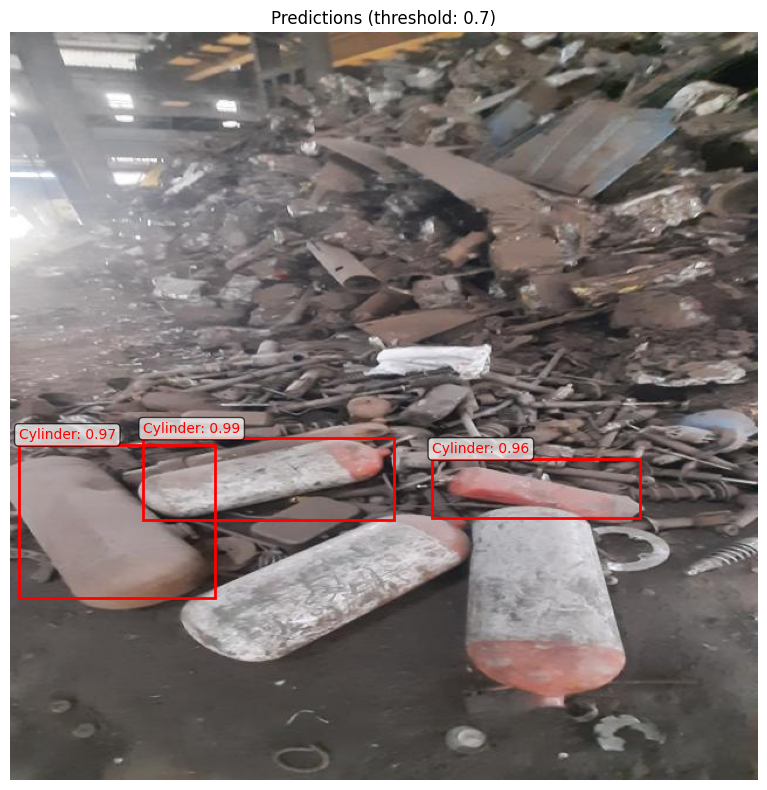

Testing:   6%|▌         | 2/34 [00:00<00:09,  3.22it/s]


Image 3:
Number of detections (confidence > 0.7): 11
Predictions:
  1. Class: Shock absorber (ID: 4), Score: 1.000, Box: [448.3, 305.8, 636.7, 503.9]
  2. Class: Shock absorber (ID: 4), Score: 0.995, Box: [244.8, 221.7, 382.6, 573.1]
  3. Class: Shock absorber (ID: 4), Score: 0.992, Box: [44.5, 86.7, 97.8, 152.5]
  4. Class: Shock absorber (ID: 4), Score: 0.991, Box: [88.8, 42.6, 157.4, 121.7]
  5. Class: Shock absorber (ID: 4), Score: 0.977, Box: [425.7, 223.1, 639.9, 445.5]
  6. Class: Shock absorber (ID: 4), Score: 0.922, Box: [0.9, 176.7, 52.9, 272.5]
  7. Class: Shock absorber (ID: 4), Score: 0.912, Box: [2.4, 128.0, 98.9, 279.9]
  8. Class: Shock absorber (ID: 4), Score: 0.844, Box: [441.4, 414.4, 603.9, 605.0]
  9. Class: Shock absorber (ID: 4), Score: 0.839, Box: [447.8, 151.7, 569.6, 271.3]
  10. Class: Shock absorber (ID: 4), Score: 0.817, Box: [152.4, 154.8, 387.5, 266.2]
  11. Class: Shock absorber (ID: 4), Score: 0.787, Box: [197.7, 467.8, 224.5, 596.9]


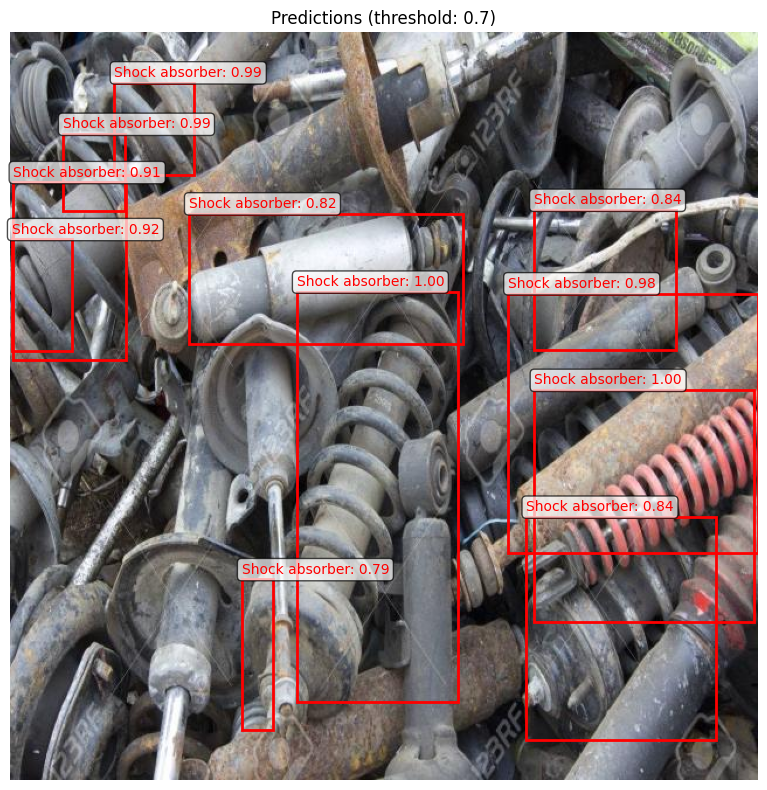

Testing:   9%|▉         | 3/34 [00:01<00:14,  2.19it/s]


Image 4:
Number of detections (confidence > 0.7): 1
Predictions:
  1. Class: container (ID: 5), Score: 0.997, Box: [16.4, 467.7, 151.8, 633.6]


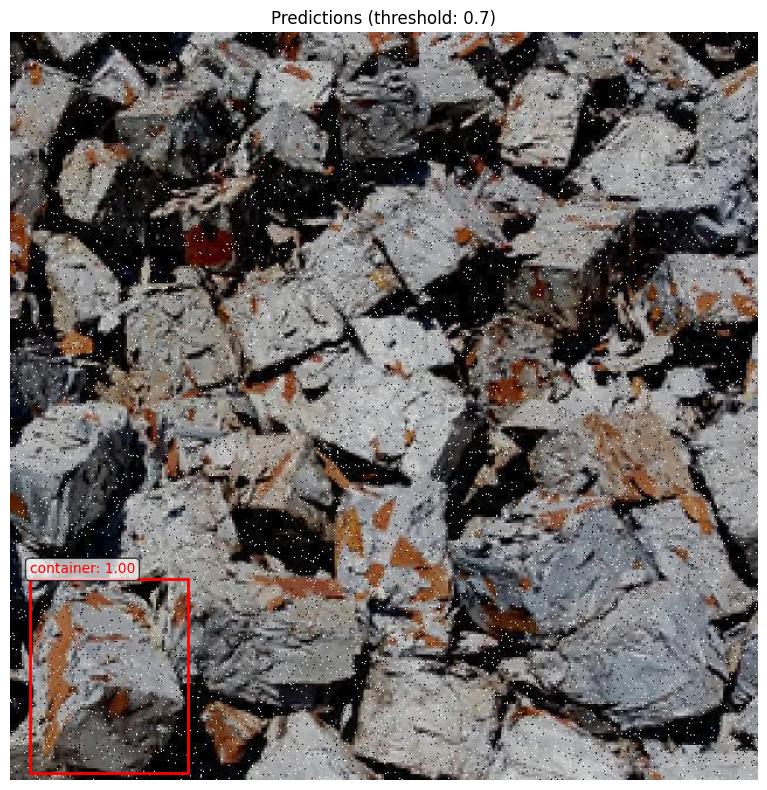

Testing:  12%|█▏        | 4/34 [00:01<00:14,  2.09it/s]


Image 5:
Number of detections (confidence > 0.7): 1
Predictions:
  1. Class: Cylinder (ID: 2), Score: 0.993, Box: [280.6, 291.5, 329.6, 345.9]


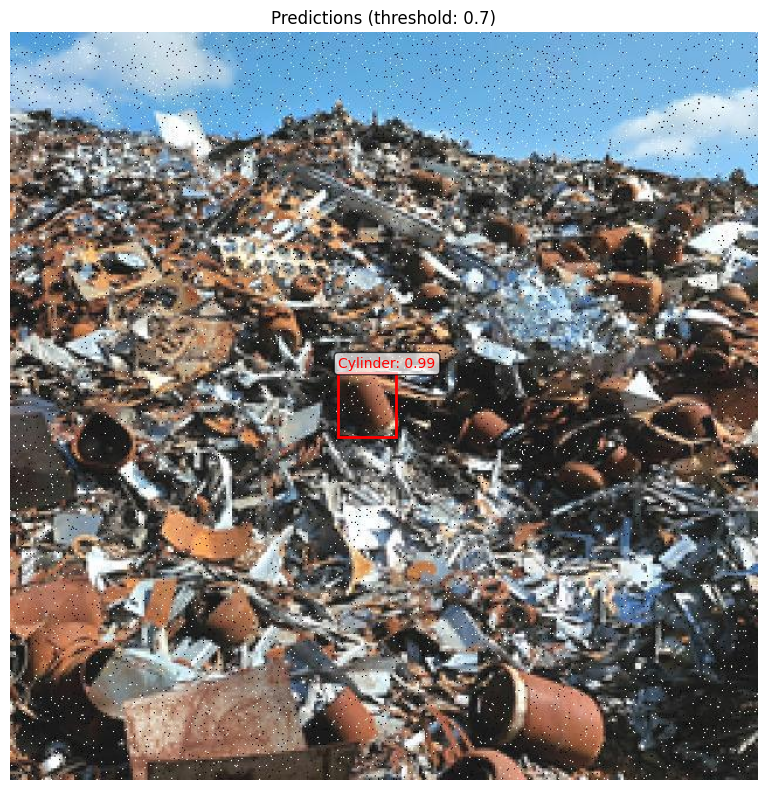

Testing:  15%|█▍        | 5/34 [00:02<00:14,  2.02it/s]


Image 6:
Number of detections (confidence > 0.7): 2
Predictions:
  1. Class: container (ID: 5), Score: 0.999, Box: [437.9, 131.0, 560.3, 189.9]
  2. Class: container (ID: 5), Score: 0.998, Box: [571.3, 125.6, 638.6, 184.6]


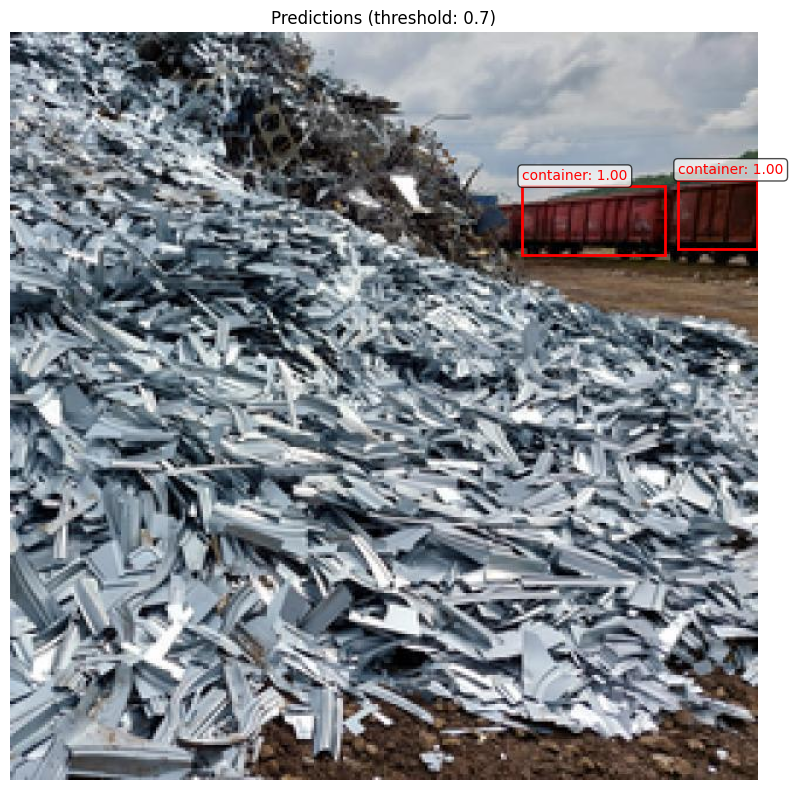

Testing:  18%|█▊        | 6/34 [00:02<00:14,  1.92it/s]


Image 7:
Number of detections (confidence > 0.7): 1
Predictions:
  1. Class: Cylinder (ID: 2), Score: 0.810, Box: [14.5, 474.9, 149.8, 575.0]


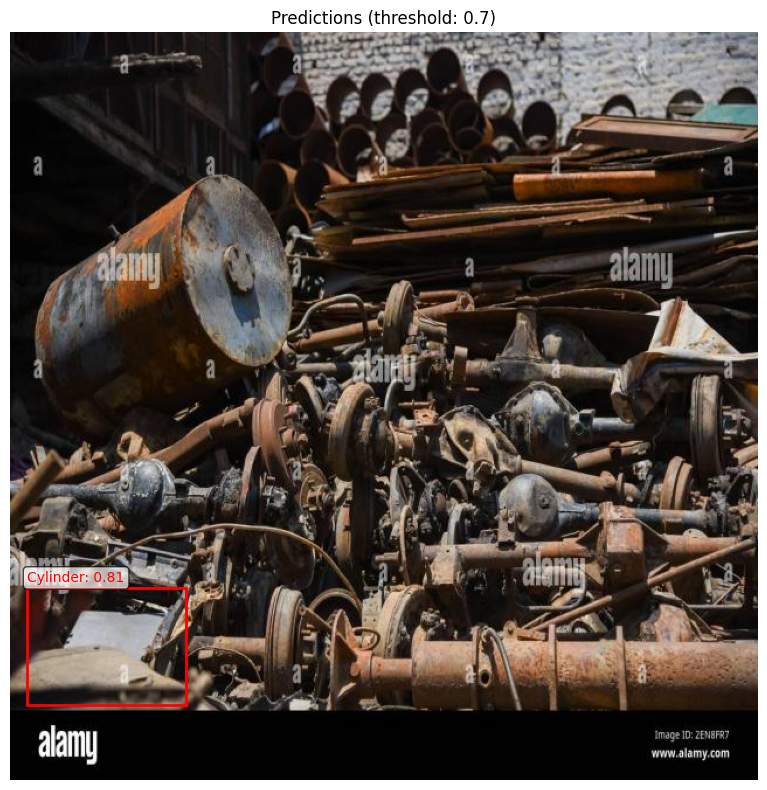

Testing:  21%|██        | 7/34 [00:03<00:14,  1.88it/s]


Image 8:
Number of detections (confidence > 0.7): 2
Predictions:
  1. Class: Cylinder (ID: 2), Score: 0.932, Box: [21.0, 402.9, 156.2, 640.0]
  2. Class: Cylinder (ID: 2), Score: 0.912, Box: [271.0, 518.7, 544.2, 628.8]


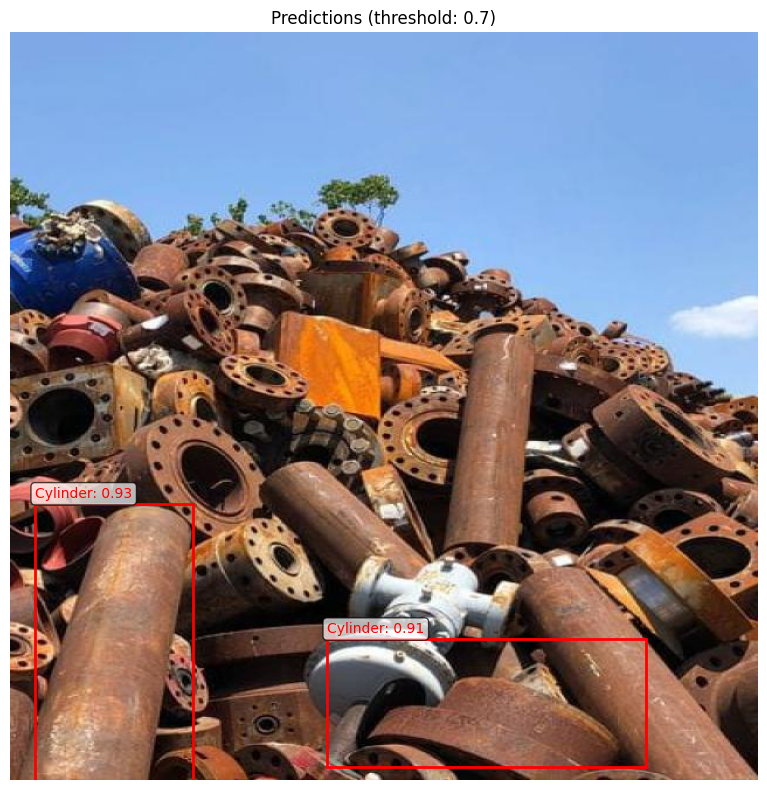

Testing:  26%|██▋       | 9/34 [00:03<00:09,  2.53it/s]


Image 9:
Number of detections (confidence > 0.7): 0
No detections above threshold

Image 10:
Number of detections (confidence > 0.7): 1
Predictions:
  1. Class: Shock absorber (ID: 4), Score: 0.863, Box: [341.3, 330.9, 485.2, 448.3]


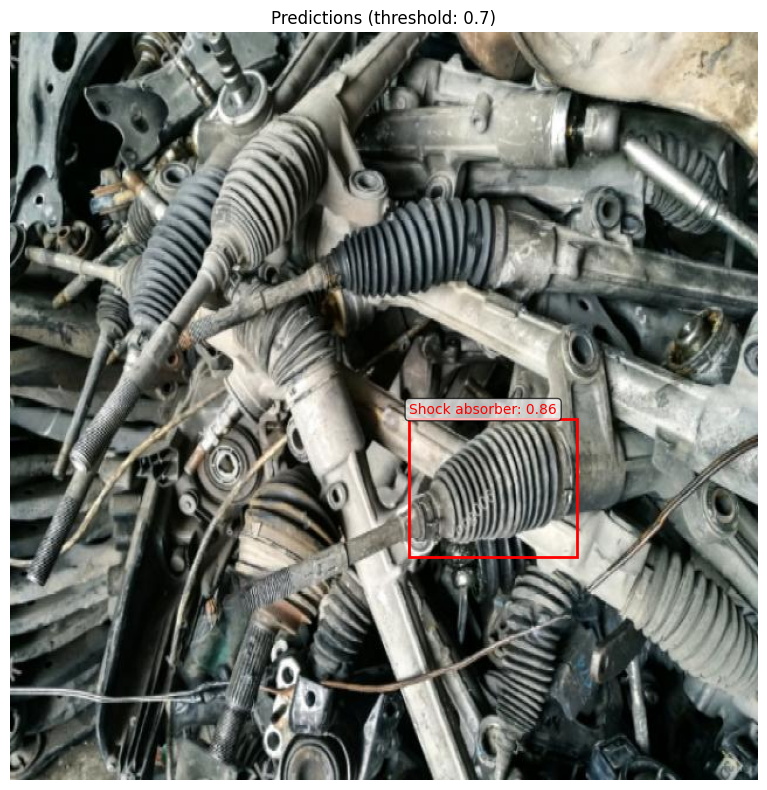

Testing:  26%|██▋       | 9/34 [00:04<00:12,  2.02it/s]


In [21]:
model.eval()

num = 0
total_predictions = 0
confidence_threshold = 0.7

with torch.no_grad():
    for images, targets in tqdm(test_loader, desc="Testing"):
        images = images.to(device)
        targets = {k: v.to(device) if isinstance(v, torch.Tensor) else v for k, v in targets.items()}
        
        # Get predictions
        outputs = model(images)
        
        # Process each image in the batch
        for i, (image, output, target) in enumerate(zip(images, outputs, targets)):
            class_ids = output["labels"].cpu()
            boxes = output["boxes"].cpu()
            scores = output["scores"].cpu()
            
            # Filter by confidence threshold
            valid_mask = scores >= confidence_threshold
            filtered_boxes = boxes[valid_mask]
            filtered_labels = class_ids[valid_mask]
            filtered_scores = scores[valid_mask]
            
            total_predictions += len(filtered_labels)
            
            print(f"\nImage {num + 1}:")
            print(f"Number of detections (confidence > {confidence_threshold}): {len(filtered_labels)}")
            
            if len(filtered_labels) > 0:
                print("Predictions:")
                for j, (box, label, score) in enumerate(zip(filtered_boxes, filtered_labels, filtered_scores)):
                    x1, y1, x2, y2 = box
                    print(f"  {j+1}. Class: {class_names[label]} (ID: {label}), "
                          f"Score: {score:.3f}, Box: [{x1:.1f}, {y1:.1f}, {x2:.1f}, {y2:.1f}]")
                
                # Visualize first few images
                if num < 10:  # Show first 5 images
                    visualize_predictions(image, filtered_boxes, filtered_labels, filtered_scores, confidence_threshold)
            else:
                print("No detections above threshold")
            
            # Print ground truth for comparison
            if 'labels' in target and 'boxes' in target:
                gt_labels = target['labels'].cpu()
                gt_boxes = target['boxes'].cpu()
                print(f"Ground truth objects: {len(gt_labels)}")
                for j, (gt_box, gt_label) in enumerate(zip(gt_boxes, gt_labels)):
                    x1, y1, x2, y2 = gt_box
                    print(f"  GT {j+1}. Class: {class_names[gt_label]} (ID: {gt_label}), "
                          f"Box: [{x1:.1f}, {y1:.1f}, {x2:.1f}, {y2:.1f}]")
            
            num += 1
            
            # Stop after testing a few images for demo
            if num >= 10:  # Test first 10 images
                break
        
        if num >= 10:
            break

In [22]:
# Visualization helper function (optional)
def visualize_polygon_to_bbox_conversion(dataset, idx):
    """
    Helper function to visualize how polygons are converted to bounding boxes
    """
    import matplotlib.pyplot as plt
    import matplotlib.patches as patches
    
    image, target = dataset[idx]
    
    # Convert tensor image back to PIL for visualization
    if isinstance(image, torch.Tensor):
        image_np = image.permute(1, 2, 0).numpy()
        if image_np.max() <= 1.0:
            image_np = (image_np * 255).astype(np.uint8)
    
    fig, ax = plt.subplots(1, 1, figsize=(10, 10))
    ax.imshow(image_np)
    
    # Draw bounding boxes
    for i, box in enumerate(target['boxes']):
        x_min, y_min, x_max, y_max = box
        width = x_max - x_min
        height = y_max - y_min
        
        rect = patches.Rectangle((x_min, y_min), width, height, 
                               linewidth=2, edgecolor='red', facecolor='none')
        ax.add_patch(rect)
        
        # Add label
        label = target['labels'][i].item()
        
        ax.text(x_min, y_min - 5, f'{class_names[label]}', fontsize=10, color='red', bbox=dict(boxstyle="round,pad=0.3", facecolor='white', alpha=0.7))
    
    ax.set_title(f'Polygon to Bounding Box Conversion - Image {idx}')
    plt.axis('off')
    plt.show()

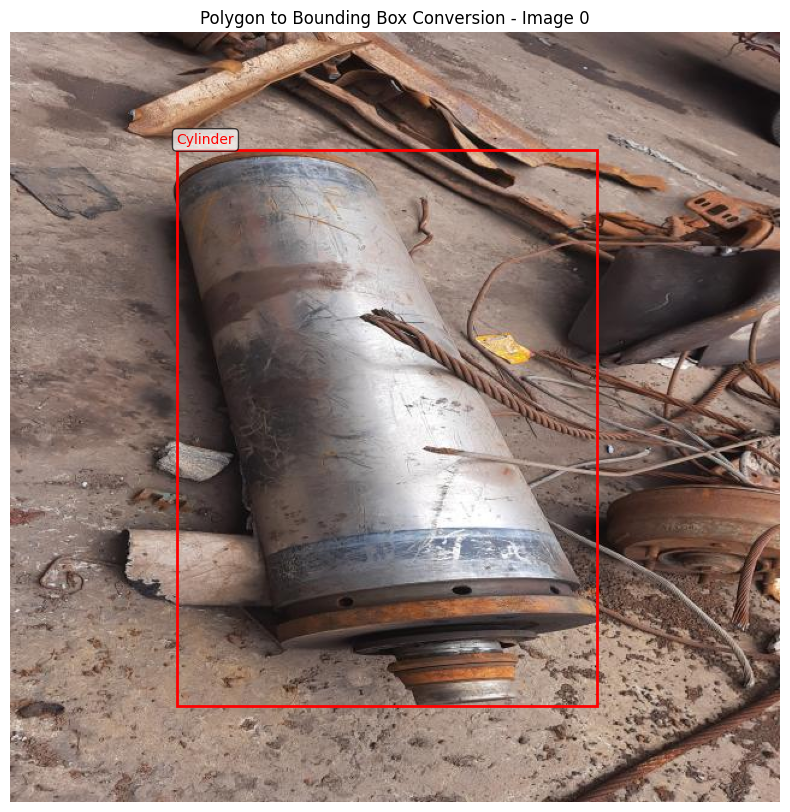

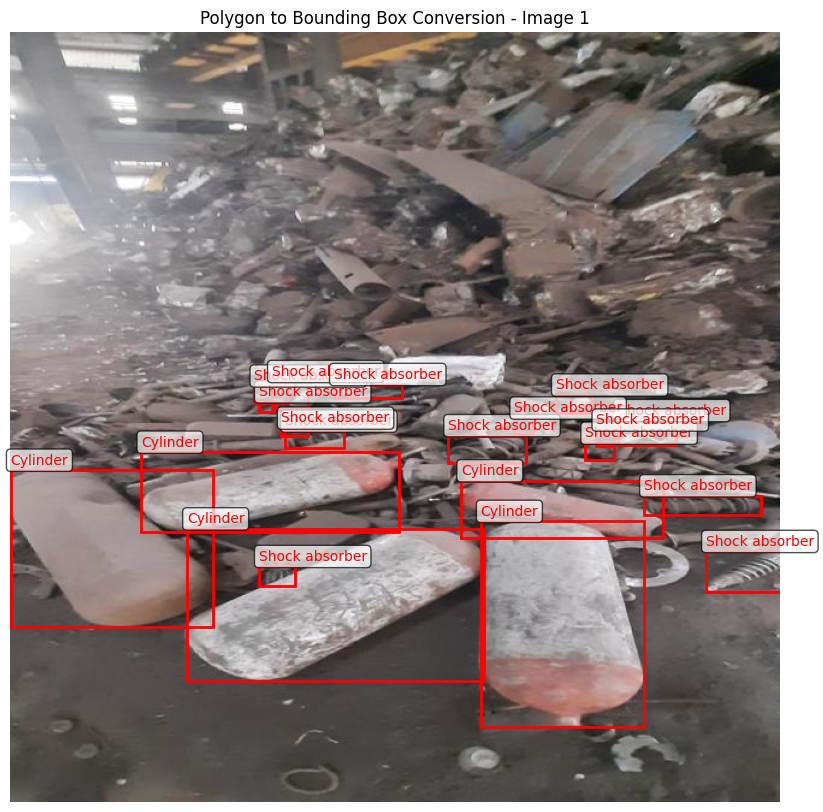

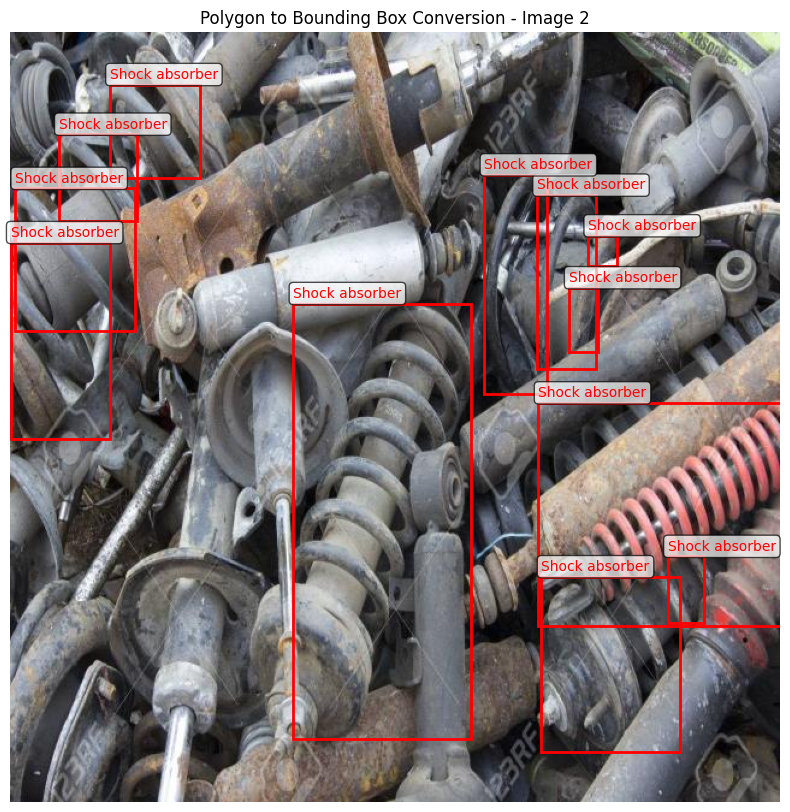

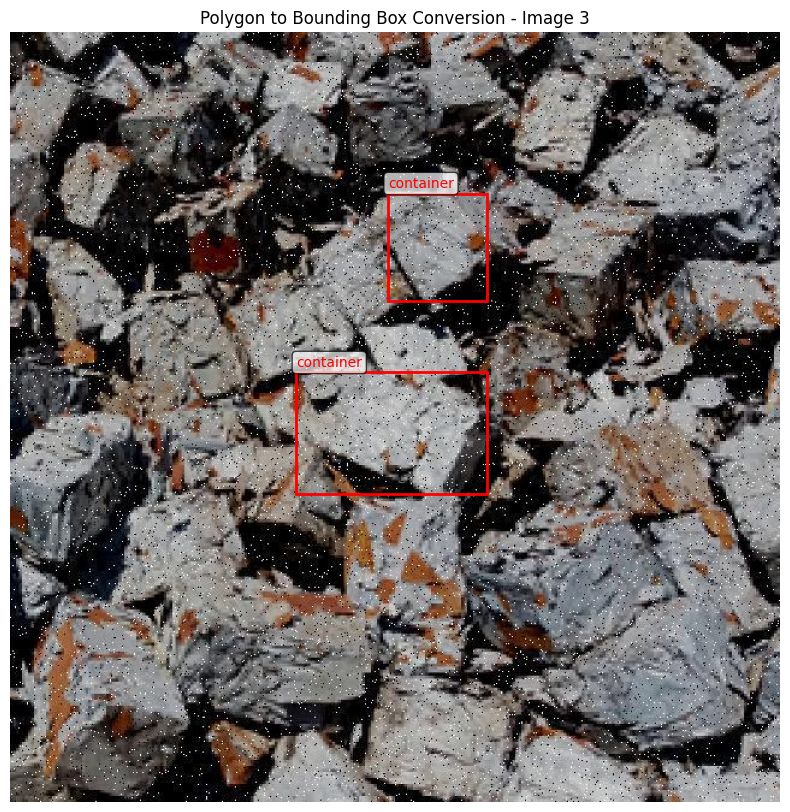

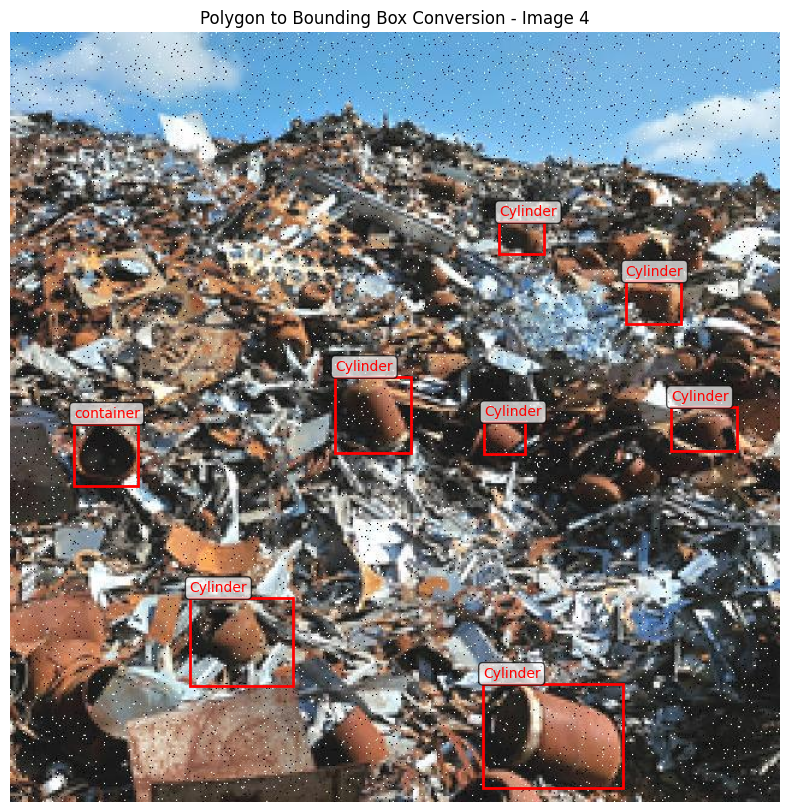

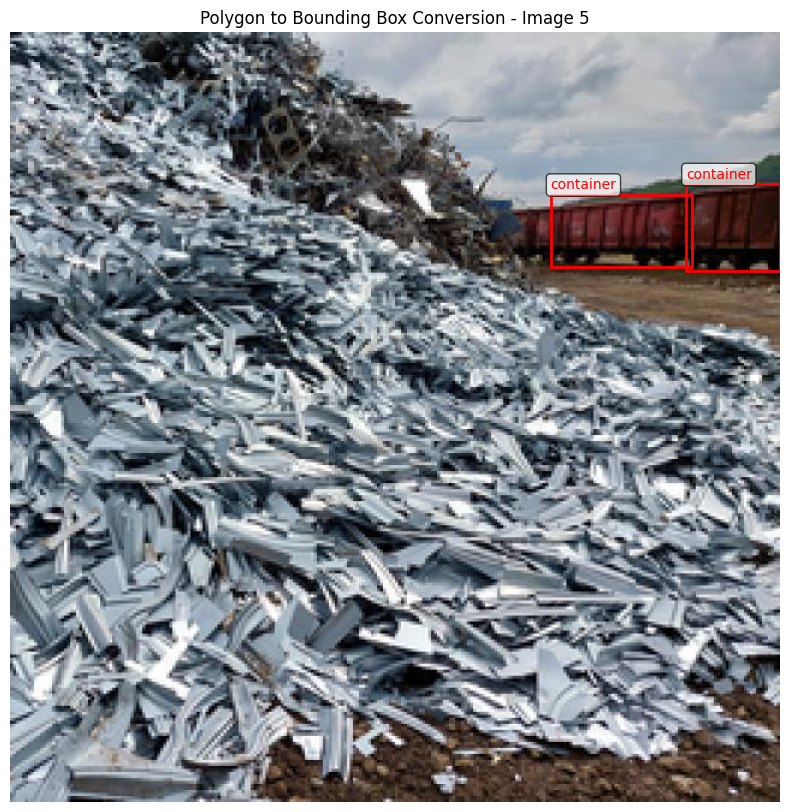

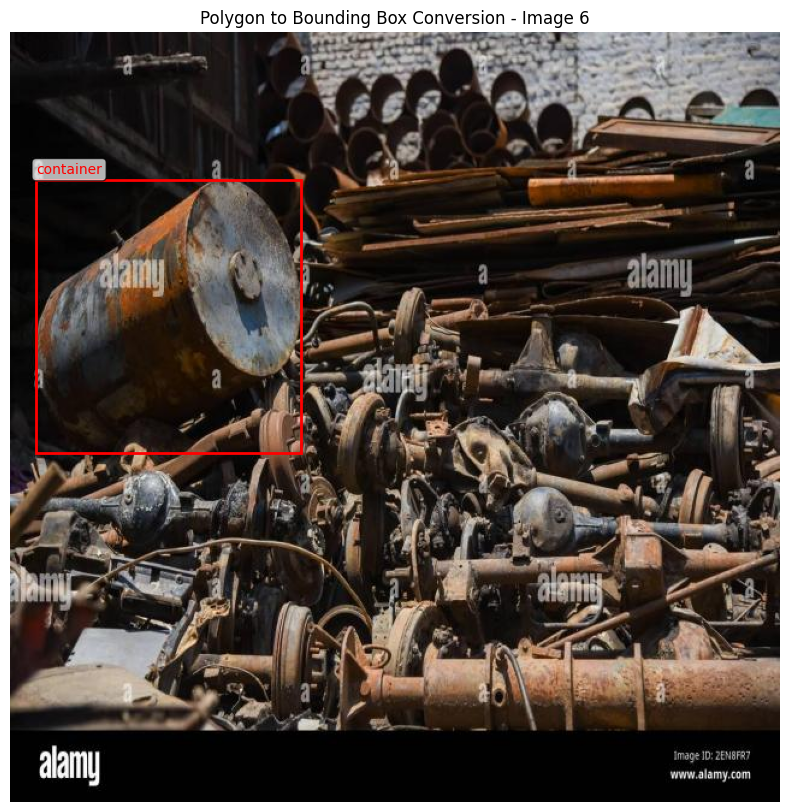

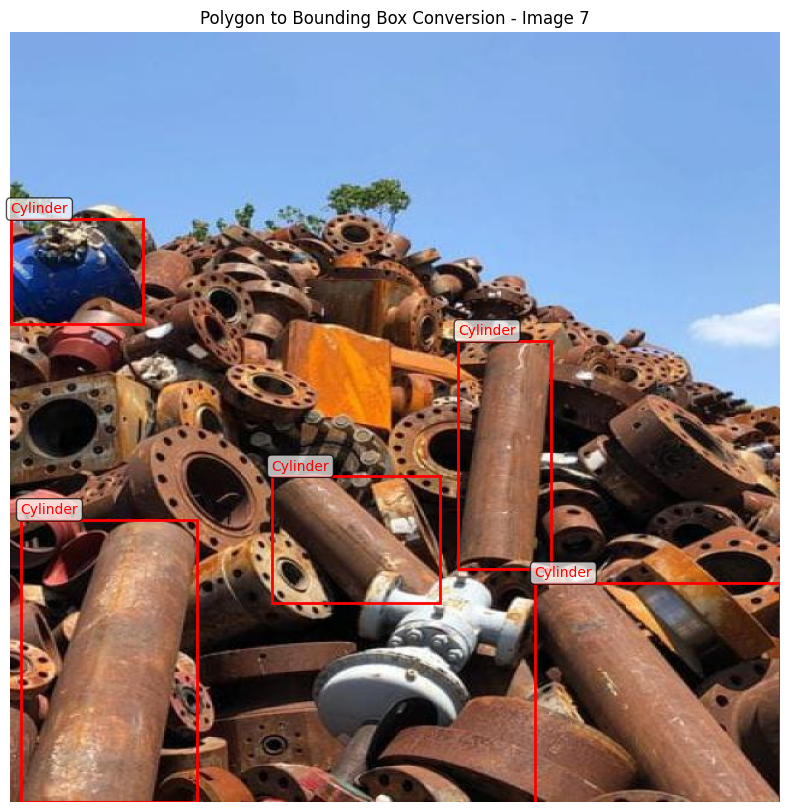

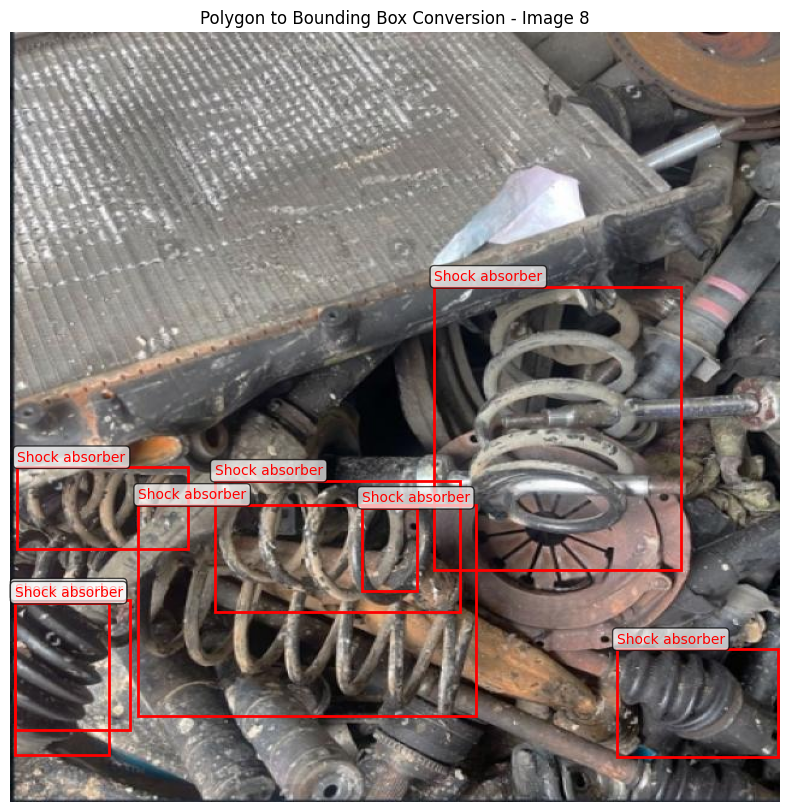

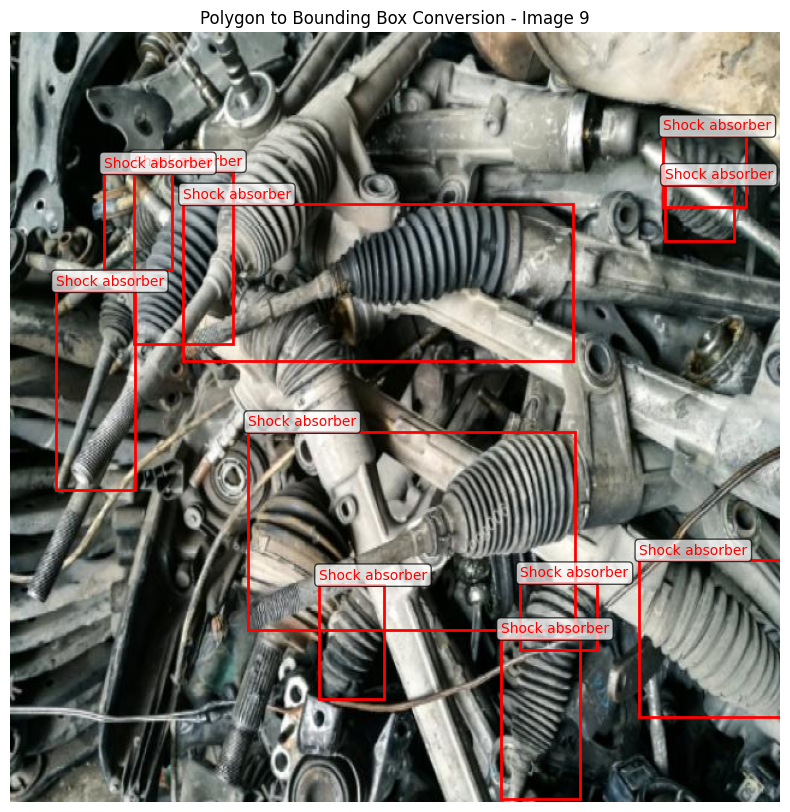

In [23]:
for i in range (10):
    visualize_polygon_to_bbox_conversion(test_dataset, i)